In [1]:
import pickle
import sys
from collections import defaultdict
from pathlib import Path

import cv2
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy.cluster.hierarchy as sch
import seaborn as sns
from matplotlib.colors import LogNorm
from mpl_toolkits.axes_grid1.inset_locator import mark_inset, zoomed_inset_axes
from skimage import measure, exposure
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from typing import List
import skimage
from operator import itemgetter 

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)

module_path = str(Path.cwd().parents[0] / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

In [4]:
import utils as utils
from config import *

In [5]:
csv_file = data_meta / "info_combined.csv"

# Read dataframe containing images information
df = pd.read_csv(csv_file)

# Read intensity per cell and scale data

In [6]:
df_intensity = pd.read_csv(data_meta / "measurements_intensity.csv")
df_morph = pd.read_csv(data_meta / "measurements_morphology.csv")
markers = df_intensity.Marker.unique()

In [7]:
# Calculate total intensity from mena intensity and area size
for row in df_intensity.itertuples():
    cond = row.Location
    i = row.Id
    total_nuclei_intensity = (
        row.Nuclei_mean_intensity
        * df_morph[(df_morph.Location == cond) & (df_morph.Id == i)][
            "Nuclei_area"
        ].item()
    )
    total_cyto_intensity = (
        row.Cyto_mean_intensity
        * df_morph[(df_morph.Location == cond) & (df_morph.Id == i)]["Cyto_area"].item()
    )
    df_intensity.loc[row.Index, "Nuclei_total_intensity"] = total_nuclei_intensity
    df_intensity.loc[row.Index, "Cyto_total_intensity"] = total_cyto_intensity

In [8]:
df_intensity = df_intensity[~df_intensity.Marker.isin(["WGA", 'Phalloidin', 'B-actin', 'Concanavalin A'])]

In [9]:
df_intensity

,Cell_mean_intensity,Nuclei_mean_intensity,Cyto_mean_intensity,Marker,Location,Id,Nuclei_total_intensity,Cyto_total_intensity
0,11788.158099,32185.806775,567.825916,Hoeschst,1,1,144417715.0,4631756.0
1,7382.506802,12458.758859,4590.163663,p-EGFR,1,1,55902451.0,37441965.0
3,8268.703417,9150.794295,7783.483143,PCNA,1,1,41059614.0,63489872.0
7,4117.120452,2580.756185,4962.243227,APC,1,1,11579853.0,40477018.0
8,6573.061689,5810.912637,6992.304401,DKK1,1,1,26073565.0,57036227.0
...,...,...,...,...,...,...,...,...
93334,5692.377801,7927.878788,5606.558568,B-tubin,9,53,3401060.0,62653292.0
93335,3570.571269,3431.109557,3575.925101,Cyclin D1,9,53,1471946.0,39960963.0
93336,1343.401586,13554.449883,874.628456,H3k27me3-488,9,53,5814859.0,9773973.0
93337,2495.286281,3918.272727,2440.658881,H3k4me3-647,9,53,1680939.0,27274363.0


In [10]:
df_cell = df_intensity[['Marker', 'Location', 'Id']]
df_cell['Intensity'] = df_intensity['Nuclei_total_intensity'] + df_intensity['Cyto_total_intensity']
df_cell = df_cell.pivot(index=['Location','Id'], columns='Marker', values="Intensity")

C:\Users\thu71\AppData\Local\Temp/ipykernel_153408/581836266.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cell['Intensity'] = df_intensity['Nuclei_total_intensity'] + df_intensity['Cyto_total_intensity']


In [11]:
scaler = MinMaxScaler()
x_scaled = scaler.fit_transform(np.log(df_cell+1))
x_scaled = scaler.fit_transform(x_scaled.T).T
df_cell_scaled = pd.DataFrame(
    x_scaled, index=df_cell.index, columns=df_cell.columns
)

In [12]:
df_cell = df_cell.rename({'Hoeschst':'DAPI'}, axis=1)

In [13]:
df_subset = df_cell[['Cyclin D1', 'DAPI']]

a_min = df_subset['DAPI'].quantile(0.1)
a_max = df_subset['DAPI'].quantile(0.99)
df_subset = df_subset[df_subset['DAPI'] < a_max]
df_subset = df_subset[df_subset['DAPI'] > a_min]

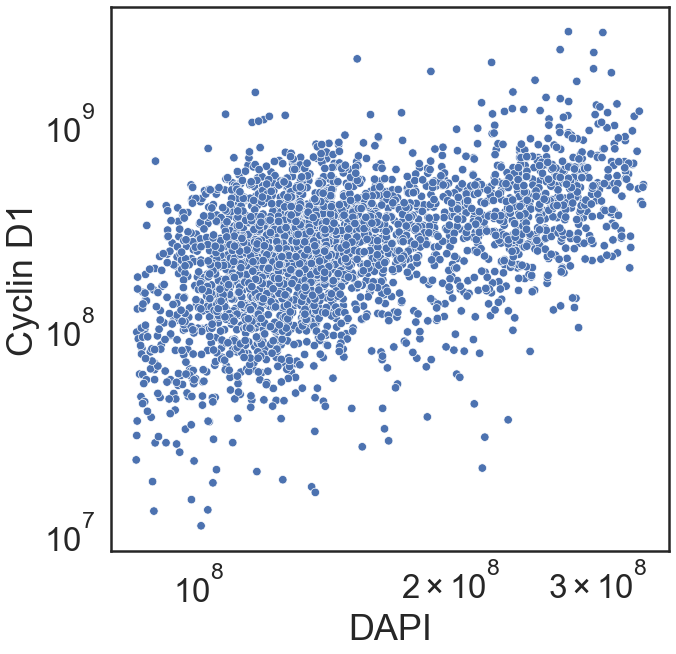

In [14]:
sns.set(style='white')
sns.set_context("poster",  font_scale=1.5)

fig,ax = plt.subplots(figsize=(10,10))
scatter = sns.scatterplot(x="DAPI", y="Cyclin D1", data=df_subset, ax=ax, size=1, legend=False)
scatter.set(xscale='log', yscale='log')
a_min = df_subset['DAPI'].quantile(0.7)
a_max = df_subset['DAPI'].quantile(0.82)
# ax.axvline(a_min, 0, 1)
# ax.axvline(a_max, 0, 1)

In [15]:
df_cell['Label'] = 'G1'
df_cell.loc[df_cell.DAPI > a_min, 'Label'] = 'S'
df_cell.loc[df_cell.DAPI > a_max, 'Label'] = 'G2'

In [16]:
df_nuclei = df_intensity[['Marker', 'Location', 'Id']]
df_nuclei['Intensity'] = df_intensity['Nuclei_total_intensity']
df_nuclei = df_nuclei.pivot(index=['Location','Id'], columns='Marker', values="Intensity")
df_nuclei['Label'] = df_cell['Label']

C:\Users\thu71\AppData\Local\Temp/ipykernel_153408/1287772530.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_nuclei['Intensity'] = df_intensity['Nuclei_total_intensity']


In [17]:
df_cycle = pd.melt(df_nuclei, id_vars=['Label'], value_name='Intensity')

In [18]:
# from statannot import add_stat_annotation
# sns.set_style("ticks")
# sns.set_context("talk")

# df_cycle = df_cycle[~df_cycle.Marker.isin(['B-actin', 'B-tubulin'])]
# markers = df_cycle.Marker.unique()

In [19]:
# df_cycle

In [20]:
# marker_set = markers[:12]
# df_subset = df_cycle[df_cycle.Marker.isin(marker_set)]
# fig, ax = plt.subplots(figsize=(23, 10))
# ax = sns.boxplot(data=df_subset, x='Marker', y='Intensity', hue='Label', palette="Set1")
# ax.legend(loc="center right",
#         bbox_to_anchor=(1.15, 0.5),
#         ncol=1,
#         fancybox=True,
#         framealpha=1,
#         shadow=True,
#         borderpad=1)
# # ax.set_yscale("log")
# sns.despine()


In [21]:
# marker_set = markers[12:]
# df_subset = df_cycle[df_cycle.Marker.isin(marker_set)]
# fig, ax = plt.subplots(figsize=(23, 10))
# ax = sns.boxplot(data=df_subset, x='Marker', y='Intensity', hue='Label', palette="Set1")
# ax.legend(loc="center right",
#         bbox_to_anchor=(1.15, 0.5),
#         ncol=1,
#         fancybox=True,
#         framealpha=1,
#         shadow=True,
#         borderpad=1)
# # ax.set_yscale("log")
# sns.despine()


In [22]:
# import chart_studio
# chart_studio.tools.set_credentials_file(username='thomashu96', api_key='3ibORctBES8H2sJDg74M')

In [23]:
# import plotly.express as px
# import plotly.graph_objects as go
# import chart_studio.plotly as py


# fig = go.Figure(data=go.Scatter(x=df_subset["DAPI"],
#                                 y=df_subset["Cyclin E"],
#                                 mode='markers',
#                                 text=df_subset.index.tolist())) # hover text goes here
# fig.update_layout(xaxis_type="log", yaxis_type="log", width=800, height=800)
# # py.plot(fig)

# Generate Hoescht and Cycle D plot

In [24]:
df_img = df[df.After_bleach == False]
df_img = df_img[df_img.Cycle == 'Cycle4']
df_img = df_img[df_img.Marker.isin(['Hoeschst', 'Cyclin E'])]

In [25]:
df_img

,Cycle,Location,Channel,Marker,Path,After_bleach
26,Cycle4,1,CH2,Cyclin E,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
30,Cycle4,1,CH1,Hoeschst,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
98,Cycle4,2,CH2,Cyclin E,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
102,Cycle4,2,CH1,Hoeschst,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
170,Cycle4,3,CH2,Cyclin E,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
...,...,...,...,...,...,...
4350,Cycle4,61,CH1,Hoeschst,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
4418,Cycle4,62,CH2,Cyclin E,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
4422,Cycle4,62,CH1,Hoeschst,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False
4490,Cycle4,63,CH2,Cyclin E,Y:\coskun-lab\Thomas\Spatial signaling\dataset...,False


In [26]:
masks = utils.get_masks(data_mask)

C:\Users\thu71\AppData\Local\Temp/ipykernel_153408/413249777.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2, figsize=(20, 10))


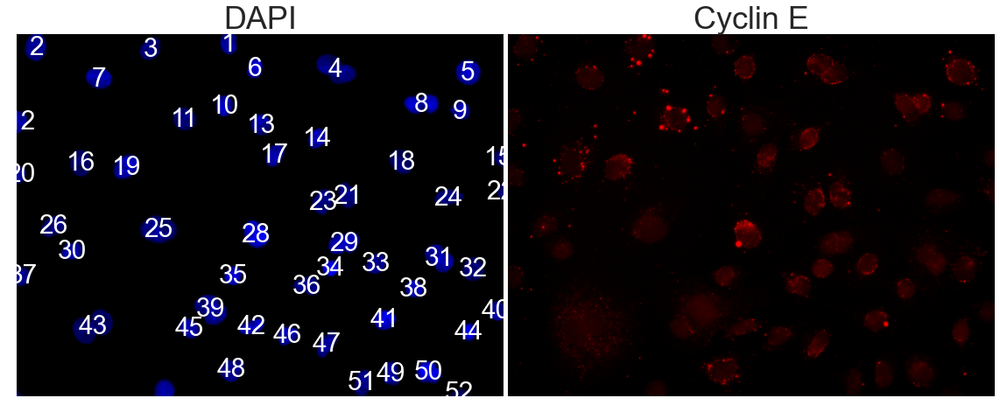

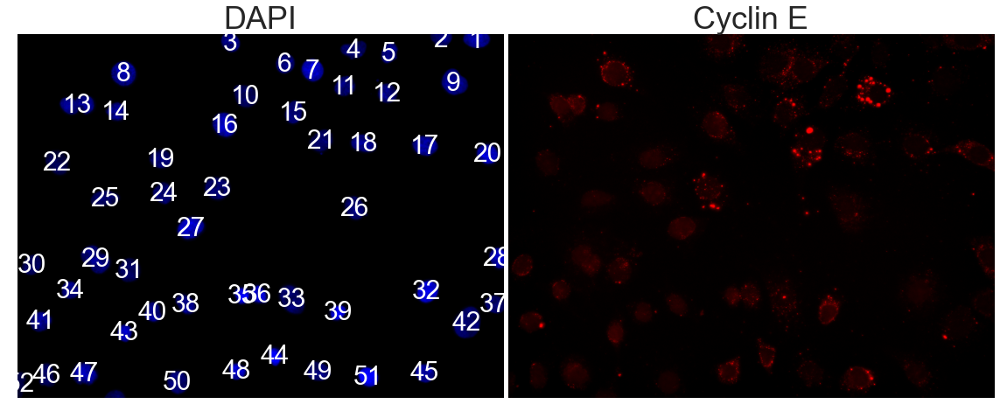

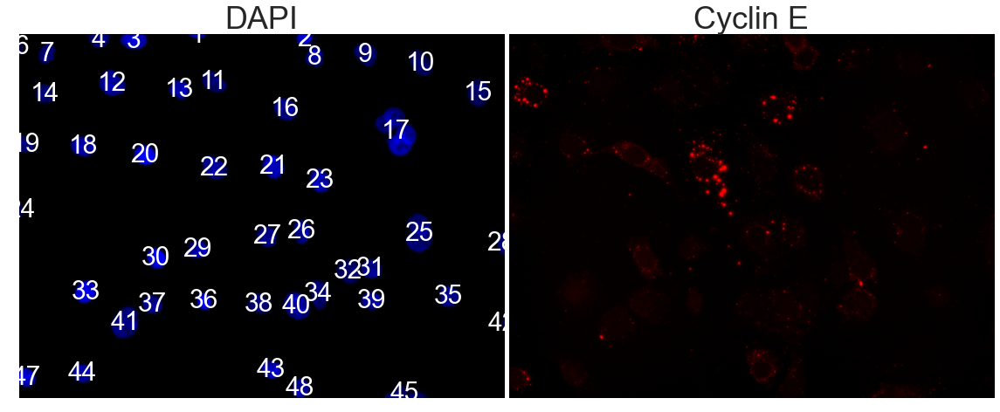

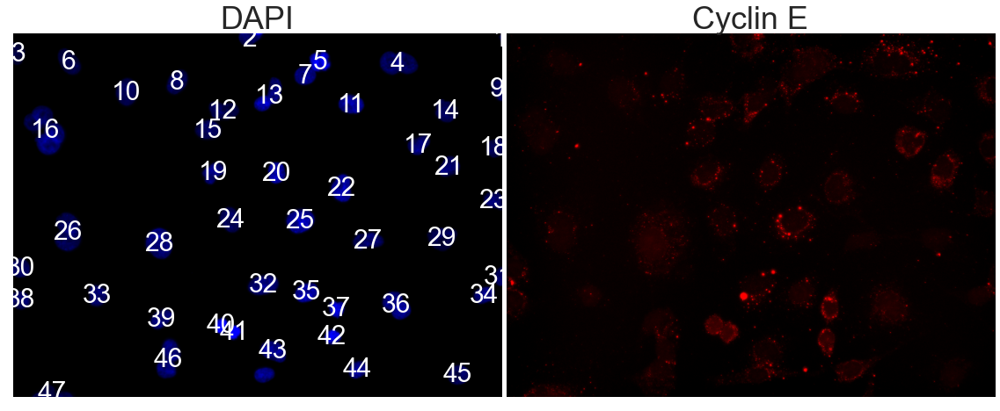

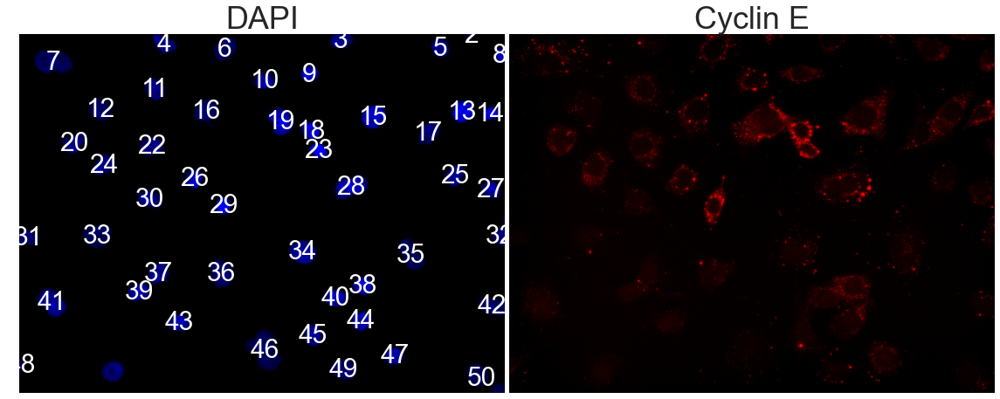

...

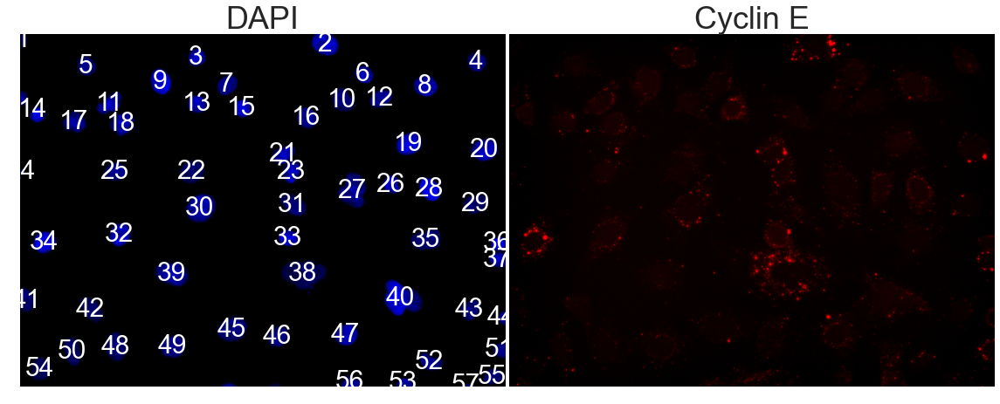

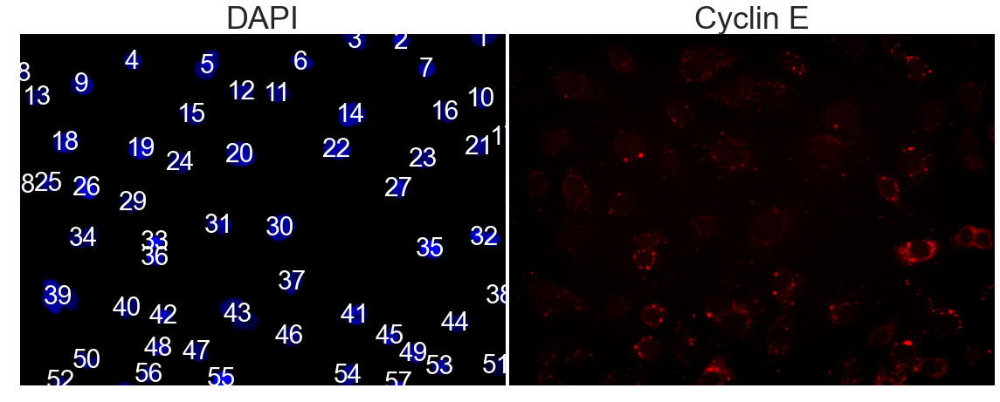

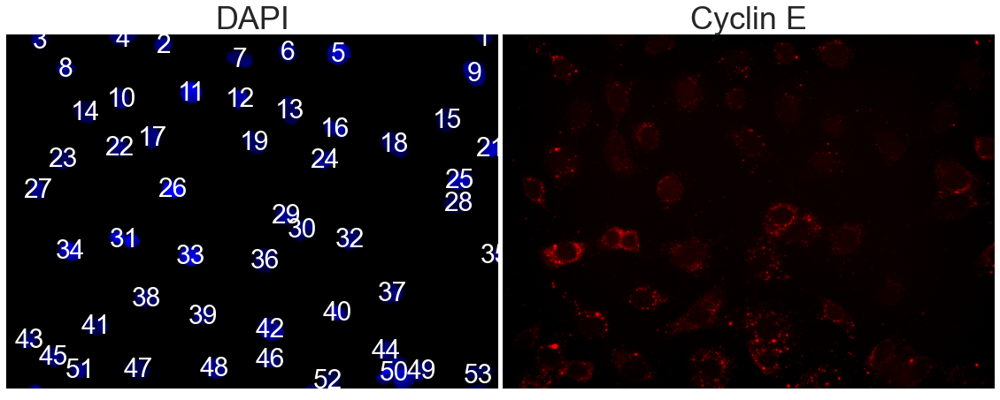

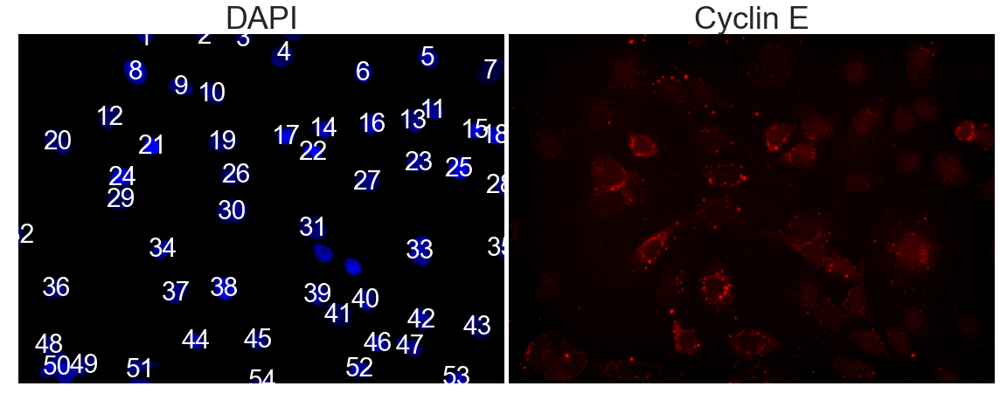

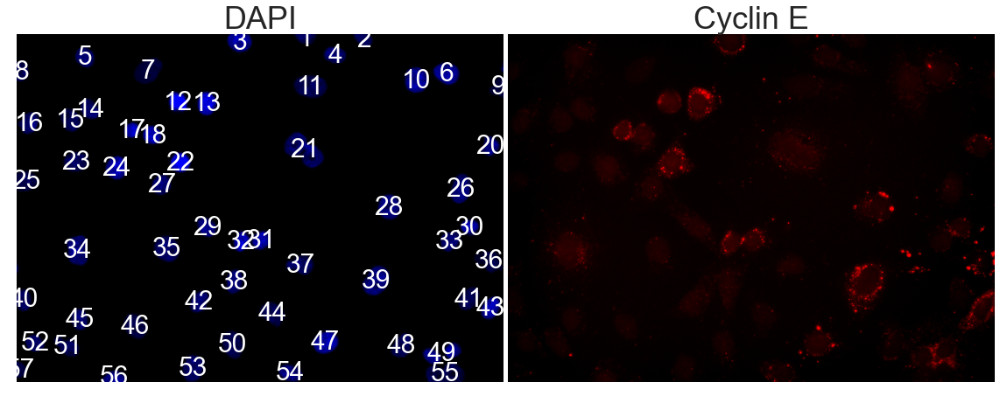

In [27]:
grouped = df_img.groupby('Location')

RGB_MAP = {
    1: {"rgb": np.array([255, 0, 0]), "range": [0, 65536]},
    2: {"rgb": np.array([0, 0, 255]), "range": [0, 65536]},
}


for name, df_group in grouped:
    dapi = df_group[df_group.Marker == 'Hoeschst'].Path.item()
    cd = df_group[df_group.Marker == 'Cyclin E'].Path.item()
    
    img_dapi = skimage.io.imread(dapi)
    p2, p98 = np.percentile(img_dapi, (0, 99.9))
    img_dapi = exposure.rescale_intensity(img_dapi, in_range=(p2, p98))
    
    img_cd = skimage.io.imread(cd)
    p2, p98 = np.percentile(img_cd, (0, 99.9))
    img_cd = exposure.rescale_intensity(img_cd, in_range=(p2, p98))
    
    img_dapi = utils.one_channel(img_dapi[:,:,np.newaxis], 2, vmax=255, rgb_map=RGB_MAP)
    img_cd = utils.one_channel(img_cd[:,:,np.newaxis], 1, vmax=255, rgb_map=RGB_MAP)
    
    # Get centroid of mask
    mask_cyto = masks[str(name)]["cyto"]
    mask_nuclei = masks[str(name)]["nuclei"]
    _, cell, _ = utils.qc_nuclei(mask_cyto, mask_nuclei)
    
    props = measure.regionprops_table(cell, properties=["label", "centroid"])
    labels = props["label"]
    ys = props["centroid-0"]
    xs = props["centroid-1"]
    
    # Plot
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].imshow(img_dapi)
    ax[0].axis('off')
    ax[0].title.set_text('DAPI')
    ax[1].imshow(img_cd)
    ax[1].axis('off')
    ax[1].title.set_text('Cyclin E')
    for idx, (x, y) in enumerate(zip(xs, ys)):
        ax[0].annotate(
            labels[idx], (x, y), fontsize=30, c="white", ha="center", va="center"
        )
    
    fig.subplots_adjust(wspace=0.01)
    fig.savefig(figure_dir / 'cell_cycle' / f'{str(name)}_DAPI_CycE.png', bbox_inches='tight', dpi=100)

In [50]:
df_img = df[df.After_bleach == False]
df_img = df_img[df_img.Cycle == 'Cycle8']
df_img = df_img[df_img.Marker.isin(['Hoeschst', 'Cyclin D1'])]

C:\Users\thu71\AppData\Local\Temp/ipykernel_153408/1040667135.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2, figsize=(20, 10))


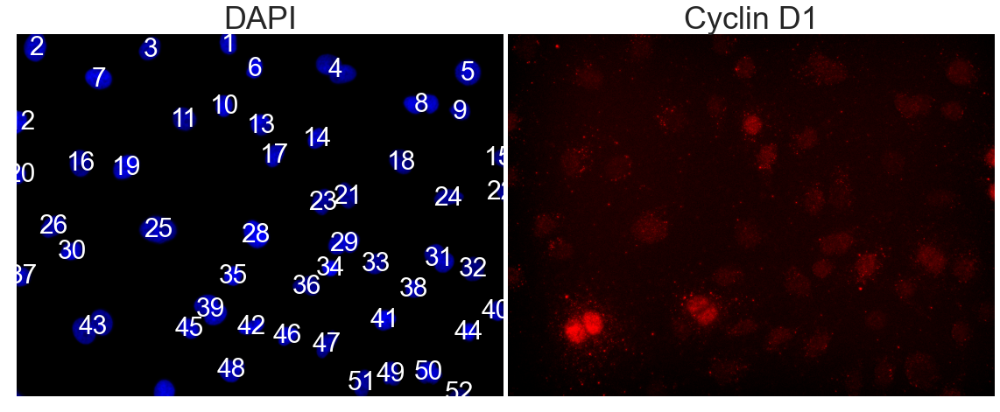

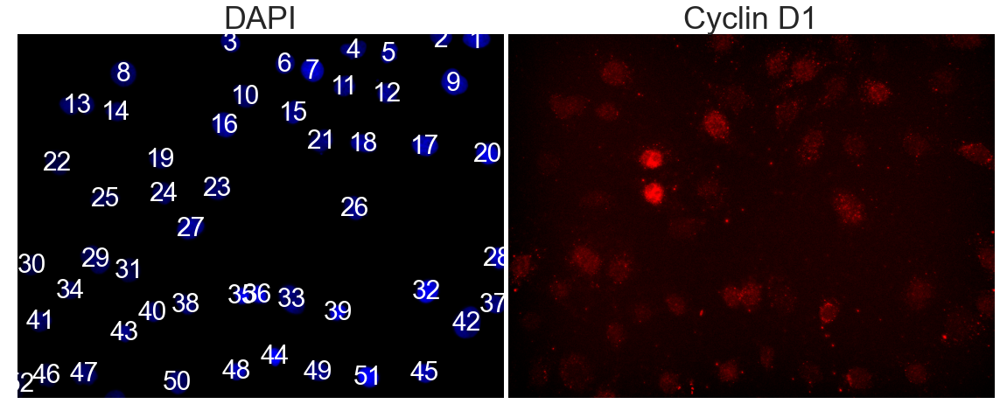

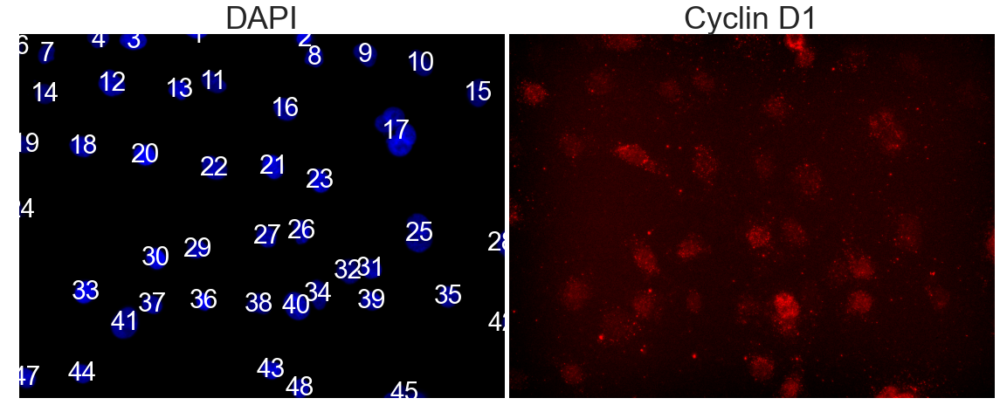

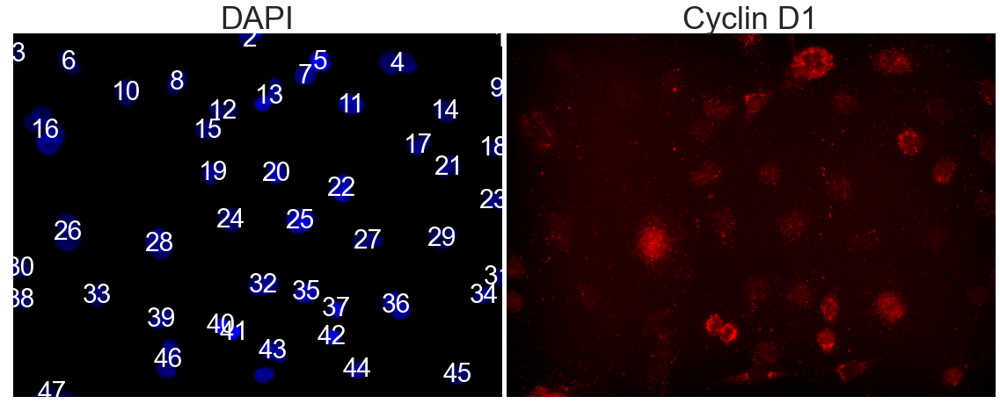

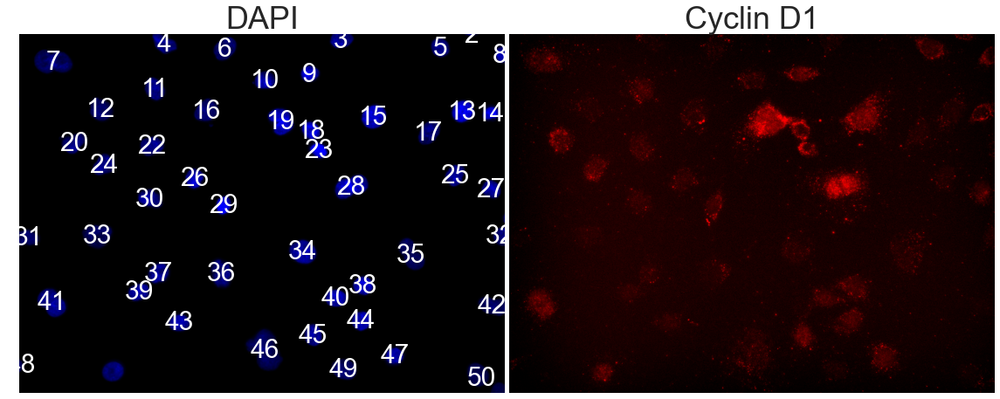

...

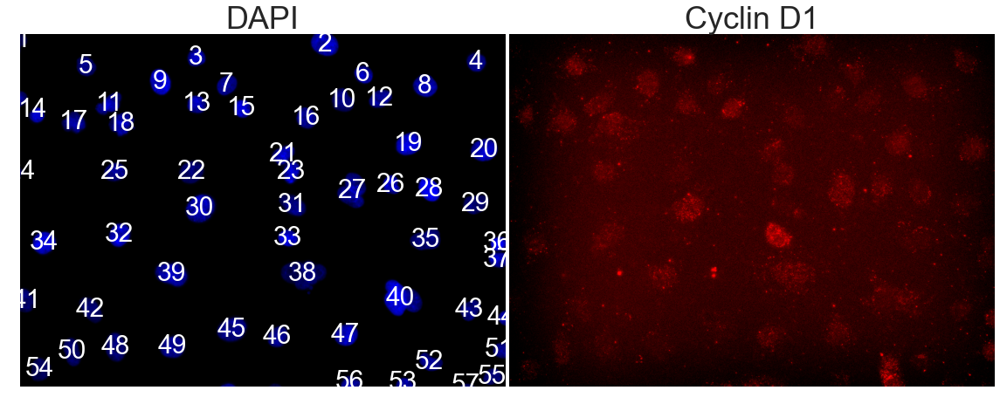

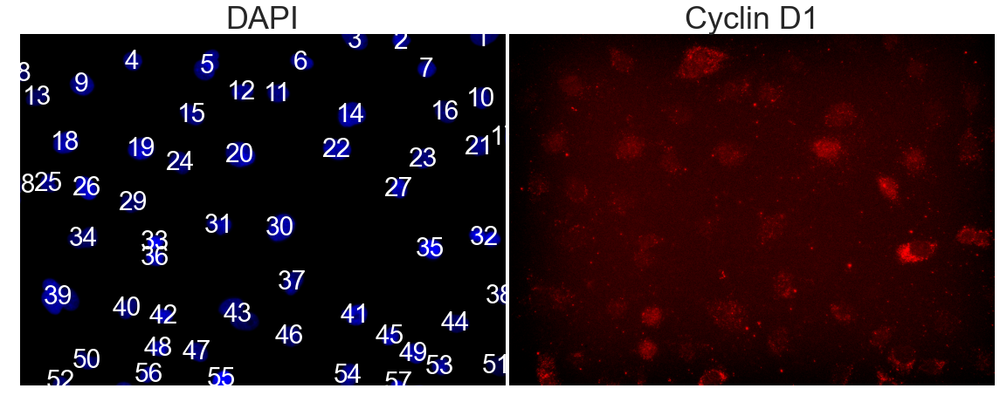

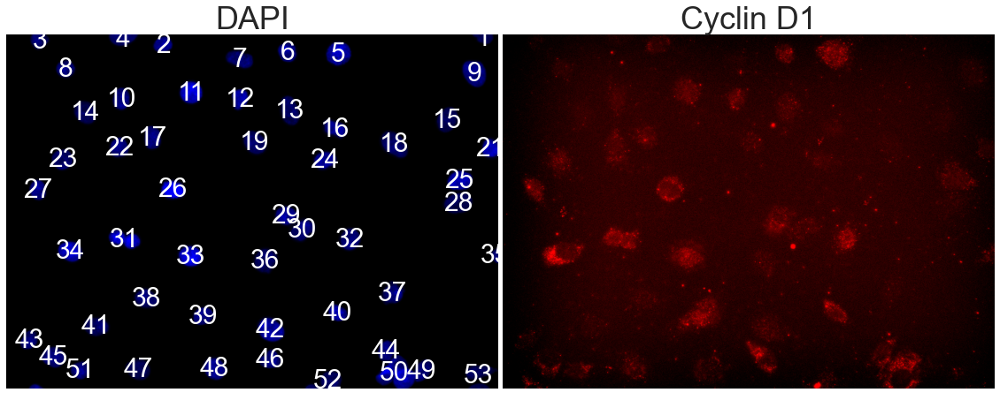

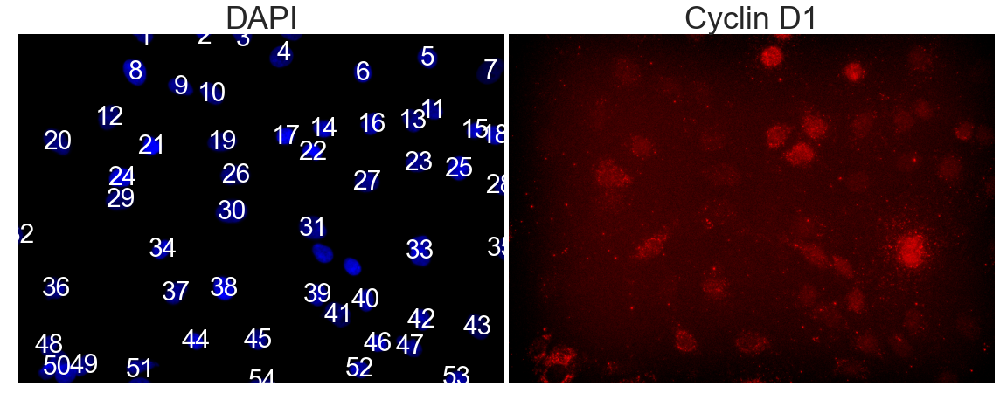

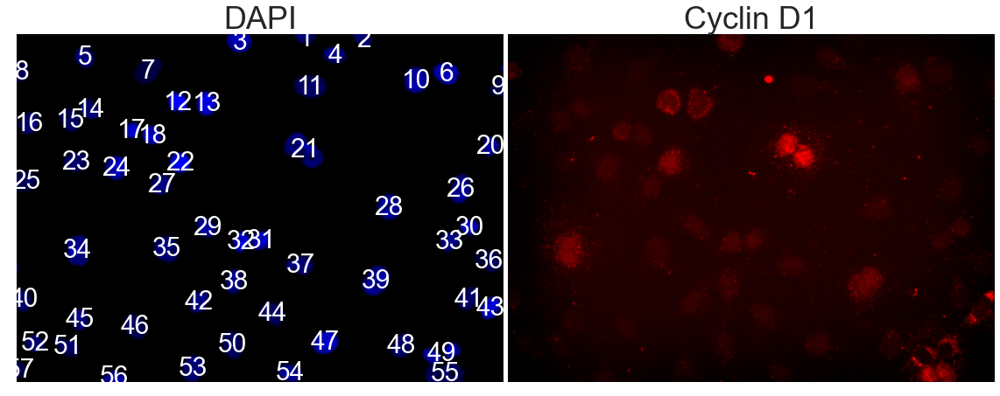

In [53]:
grouped = df_img.groupby('Location')

RGB_MAP = {
    1: {"rgb": np.array([255, 0, 0]), "range": [0, 65536]},
    2: {"rgb": np.array([0, 0, 255]), "range": [0, 65536]},
}


for name, df_group in grouped:
    dapi = df_group[df_group.Marker == 'Hoeschst'].Path.item()
    cd = df_group[df_group.Marker == 'Cyclin D1'].Path.item()
    
    img_dapi = skimage.io.imread(dapi)
    p2, p98 = np.percentile(img_dapi, (0, 99.9))
    img_dapi = exposure.rescale_intensity(img_dapi, in_range=(p2, p98))
    
    img_cd = skimage.io.imread(cd)
    p2, p98 = np.percentile(img_cd, (0, 99.9))
    img_cd = exposure.rescale_intensity(img_cd, in_range=(p2, p98))
    
    img_dapi = utils.one_channel(img_dapi[:,:,np.newaxis], 2, vmax=255, rgb_map=RGB_MAP)
    img_cd = utils.one_channel(img_cd[:,:,np.newaxis], 1, vmax=255, rgb_map=RGB_MAP)
    
    # Get centroid of mask
    mask_cyto = masks[str(name)]["cyto"]
    mask_nuclei = masks[str(name)]["nuclei"]
    _, cell, _ = utils.qc_nuclei(mask_cyto, mask_nuclei)
    
    props = measure.regionprops_table(cell, properties=["label", "centroid"])
    labels = props["label"]
    ys = props["centroid-0"]
    xs = props["centroid-1"]
    
    # Plot
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].imshow(img_dapi)
    ax[0].axis('off')
    ax[0].title.set_text('DAPI')
    ax[1].imshow(img_cd)
    ax[1].axis('off')
    ax[1].title.set_text('Cyclin D1')
    for idx, (x, y) in enumerate(zip(xs, ys)):
        ax[0].annotate(
            labels[idx], (x, y), fontsize=30, c="white", ha="center", va="center"
        )
    
    fig.subplots_adjust(wspace=0.01)
    fig.savefig(figure_dir / 'cell_cycle' / f'{str(name)}_DAPI_CycD.png', bbox_inches='tight', dpi=100)